In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

In [2]:
# --------------------------------------------------------------
# Load data
# --------------------------------------------------------------

df = pd.read_pickle("../../data/interim/01_data_processed.pkl")
print(df)

                            acc_x     acc_y     acc_z   gyr_x   gyr_y   gyr_z  \
epoch (ms)                                                                      
2019-01-11 15:08:05.200  0.013500  0.977000 -0.071000 -1.8904  2.4392  0.9388   
2019-01-11 15:08:05.400 -0.001500  0.970500 -0.079500 -1.6826 -0.8904  2.1708   
2019-01-11 15:08:05.600  0.001333  0.971667 -0.064333  2.5608 -0.2560 -1.4146   
2019-01-11 15:08:05.800 -0.024000  0.957000 -0.073500  8.0610 -4.5244 -2.0730   
2019-01-11 15:08:06.000 -0.028000  0.957667 -0.115000  2.4390 -1.5486 -3.6098   
...                           ...       ...       ...     ...     ...     ...   
2019-01-20 17:33:27.000 -0.048000 -1.041500 -0.076500  1.4146 -5.6218  0.2926   
2019-01-20 17:33:27.200 -0.037000 -1.030333 -0.053333 -2.7684 -0.5854  2.2440   
2019-01-20 17:33:27.400 -0.060000 -1.031000 -0.082000  2.8416 -5.1342 -0.1220   
2019-01-20 17:33:27.600 -0.038667 -1.025667 -0.044667 -0.2318  0.2562  1.1220   
2019-01-20 17:33:27.800 -0.0

                            acc_x     acc_y     acc_z    gyr_x    gyr_y  \
epoch (ms)                                                                
2019-01-11 15:10:08.400  0.003667  0.966333 -0.081000   1.8412  -4.7806   
2019-01-11 15:10:08.600 -0.012500  0.962500 -0.089000   2.1950  -2.1096   
2019-01-11 15:10:08.800 -0.028000  0.867000 -0.125000   9.5246  -2.8290   
2019-01-11 15:10:09.000 -0.062000  0.873000 -0.155000  16.5608  -4.4268   
2019-01-11 15:10:09.200 -0.096667  0.904333 -0.169000   7.6952 -11.8538   
...                           ...       ...       ...      ...      ...   
2019-01-11 15:10:24.000  0.038667  0.967667 -0.100000  -0.2194  -4.9756   
2019-01-11 15:10:24.200  0.018500  0.972500 -0.083000   0.7924  -1.8536   
2019-01-11 15:10:24.400  0.019667  0.970333 -0.079667  -1.9270   0.5852   
2019-01-11 15:10:24.600  0.009500  0.957500 -0.088000   4.1462  -2.5608   
2019-01-11 15:10:24.800  0.021000  0.966000 -0.108000   2.7435   0.5485   

                        

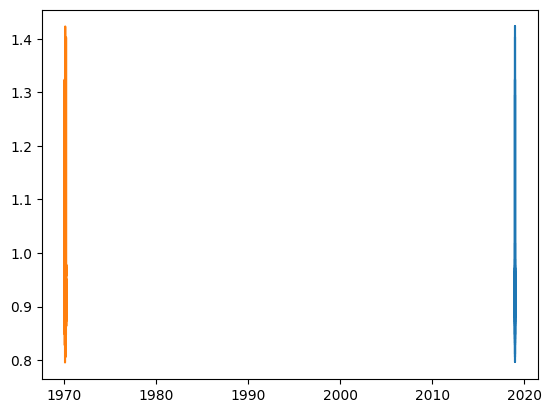

In [3]:
# --------------------------------------------------------------
# Plot single columns
# --------------------------------------------------------------

set_df = df[df["set"] == 1]
print(set_df)
plt.plot(set_df["acc_y"]) 
plt.plot(set_df["acc_y"].reset_index(drop=True))

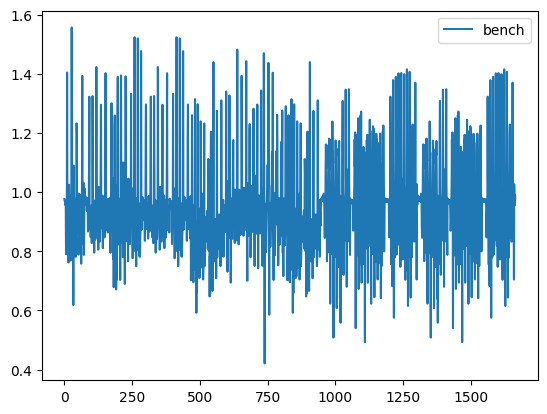

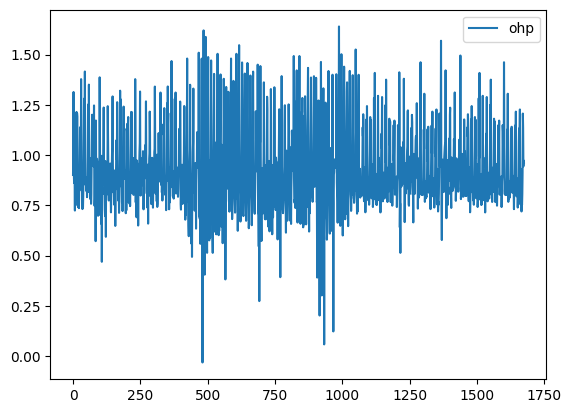

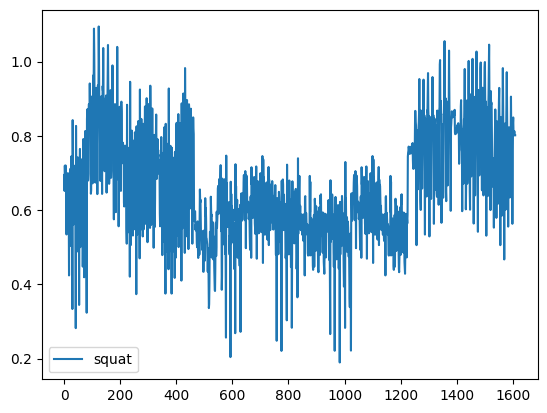

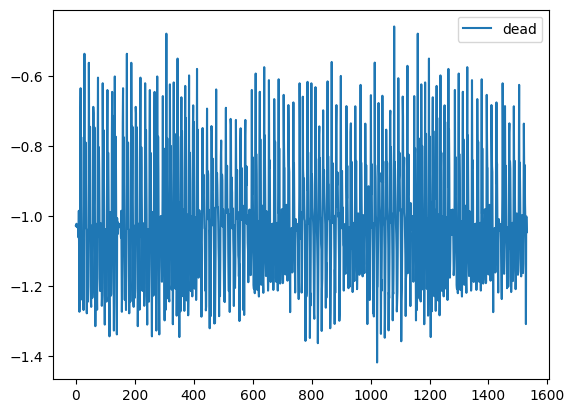

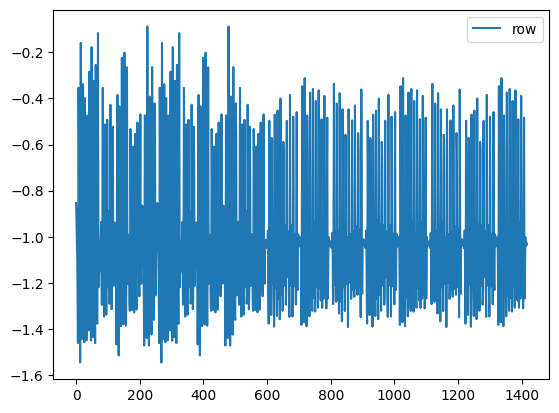

...

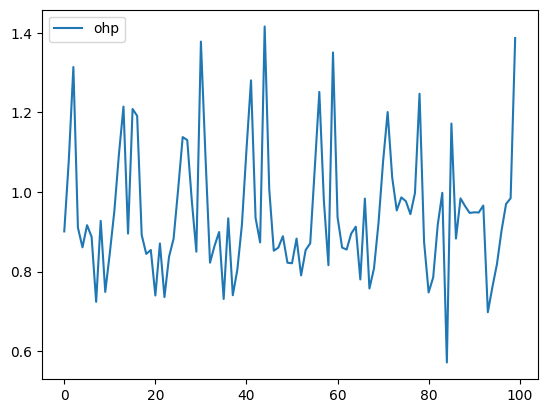

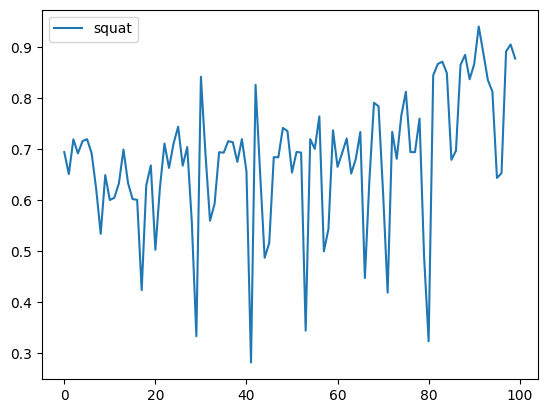

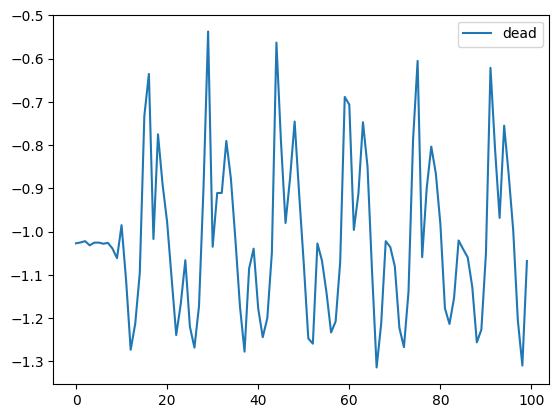

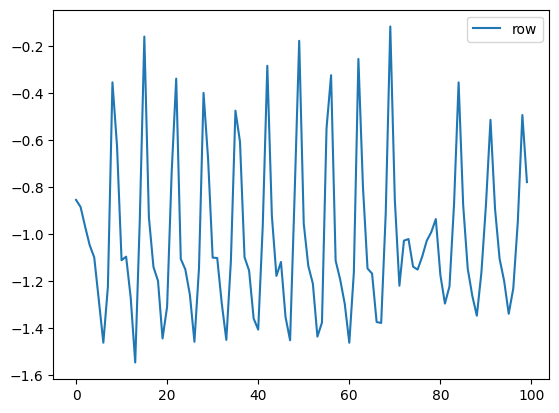

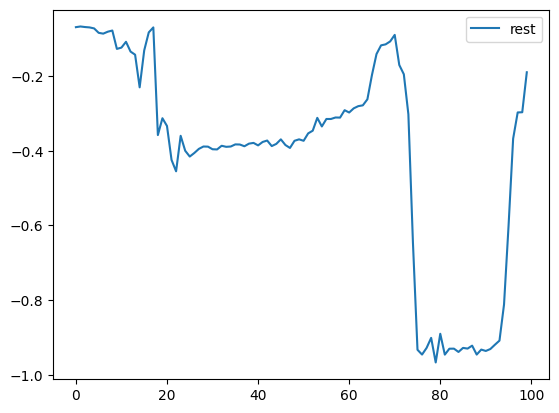

In [4]:
# --------------------------------------------------------------
# Plot all exercises
# --------------------------------------------------------------

for label in df["label"].unique():
    subset = df[df["label"] == label]
    fig, ax = plt.subplots()
    plt.plot(subset["acc_y"].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

for label in df["label"].unique():
    subset = df[df["label"] == label]
    fig, ax = plt.subplots()
    plt.plot(subset[:100]["acc_y"].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

In [5]:
# --------------------------------------------------------------
# Adjust plot settings
# --------------------------------------------------------------

mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"] = (20, 5)
mpl.rcParams["figure.dpi"] = 100


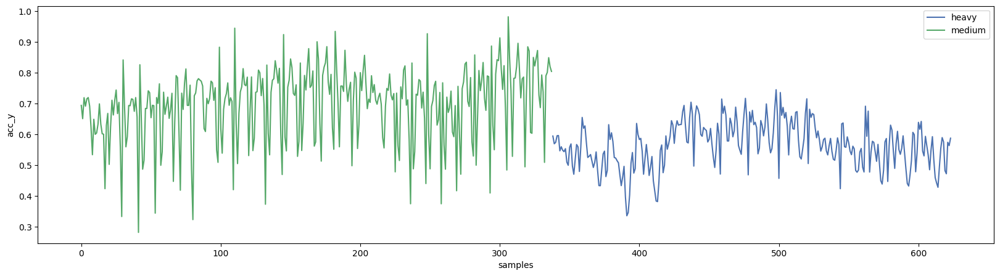

In [6]:
# --------------------------------------------------------------
# Compare medium vs. heavy sets
# --------------------------------------------------------------

category_df = df.query("label == 'squat'").query("participant == 'A'").reset_index()

fig, ax = plt.subplots()
category_df.groupby(["category"])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

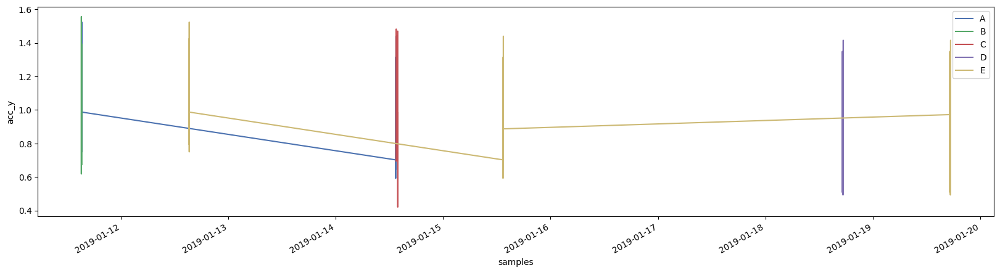

In [7]:
# --------------------------------------------------------------
# Compare participants
# --------------------------------------------------------------

participant_df = df.query("label == 'bench'").sort_values("participant")

fig, ax = plt.subplots()
participant_df.groupby(["participant"])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

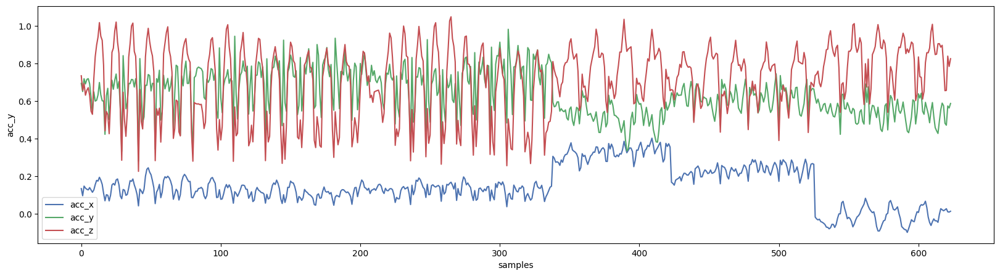

In [8]:
# --------------------------------------------------------------
# Plot multiple axis
# --------------------------------------------------------------

label = "squat"
participant = "A"
all_axis_df = df.query("label == @label and participant == @participant").reset_index()

fig, ax = plt.subplots()
all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()


C:\Users\karim\AppData\Local\Temp\ipykernel_19548\2846520586.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


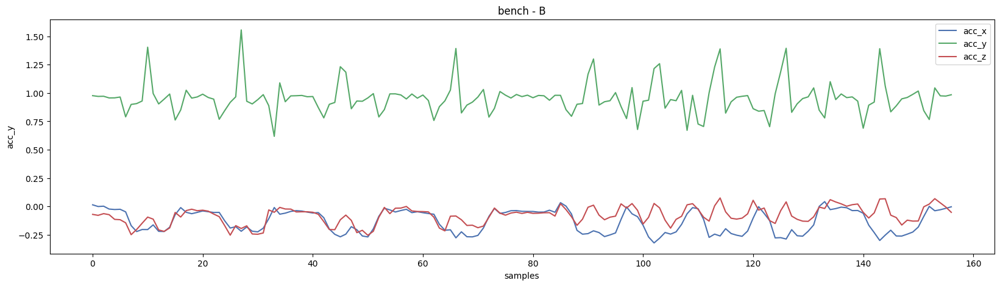

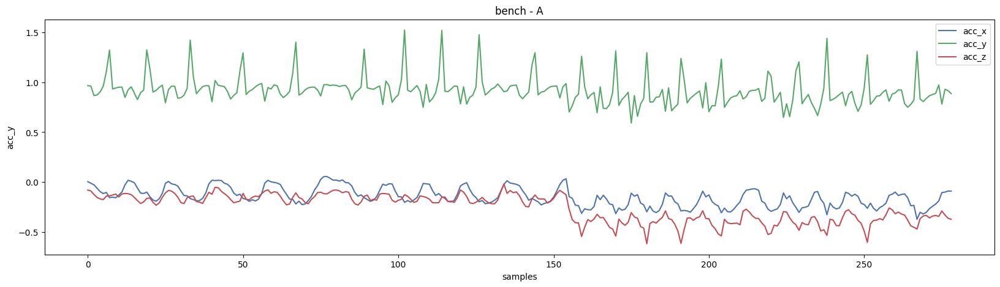

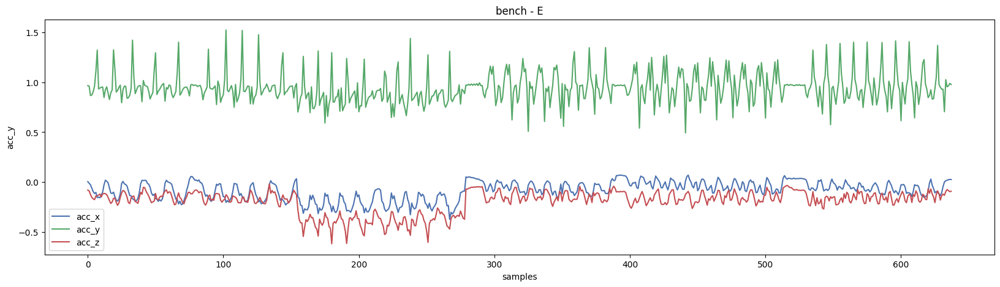

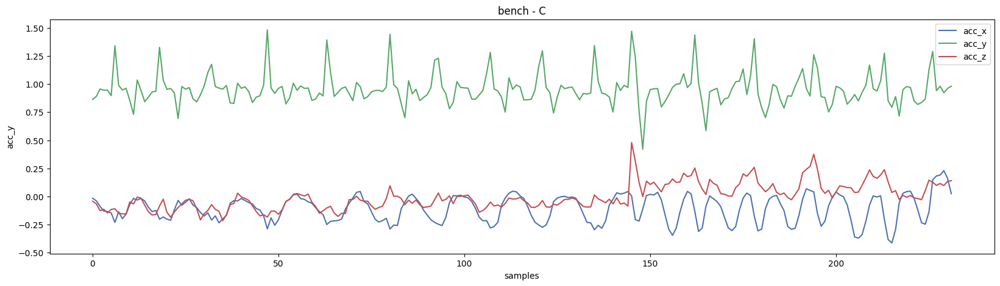

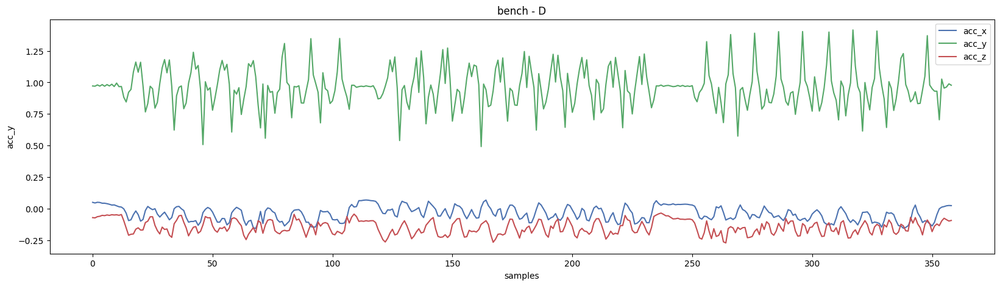

...

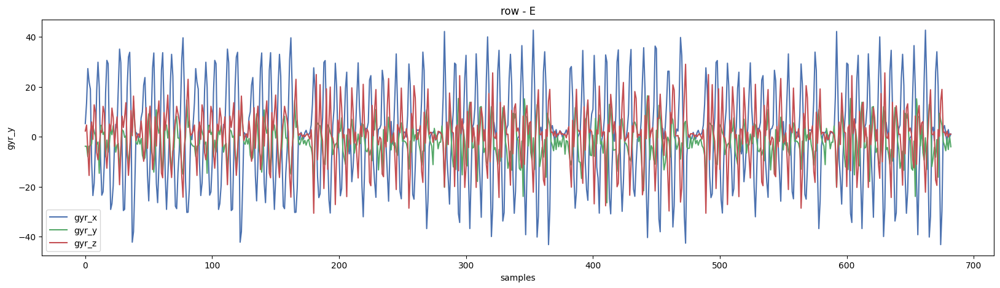

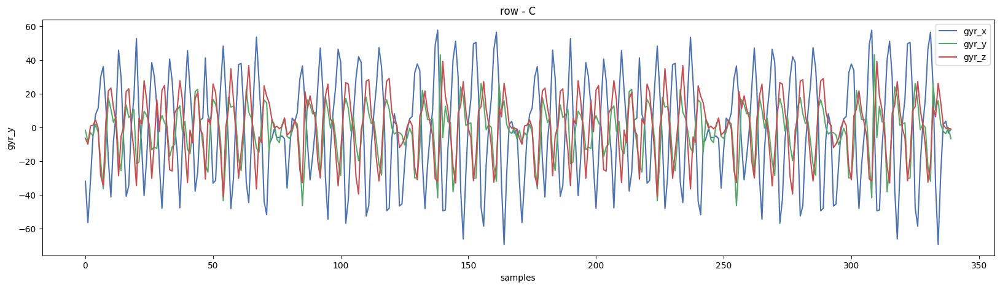

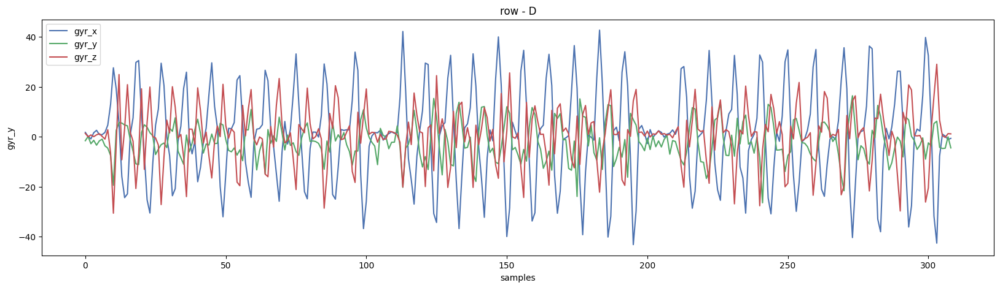

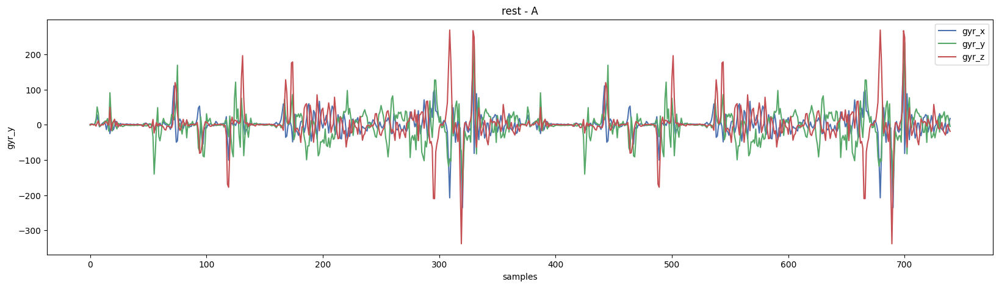

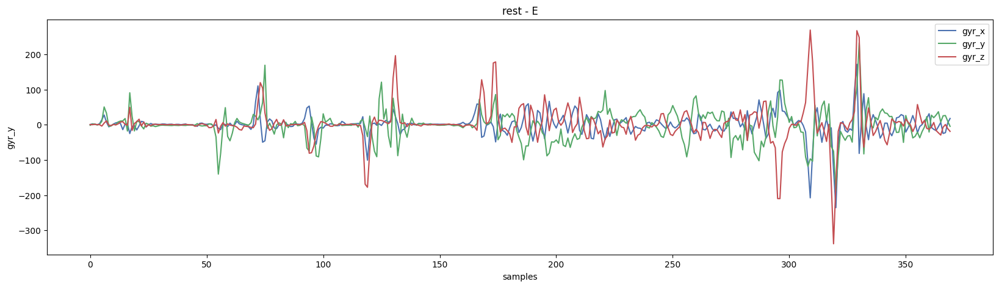

In [9]:
# --------------------------------------------------------------
# Create a loop to plot all combinations per sensor
# --------------------------------------------------------------

labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        all_axis_df = (df.query("label == @label").query("participant == @participant").reset_index())
        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
            ax.set_ylabel("acc_y")
            ax.set_xlabel("samples")
            plt.legend()
            plt.title(f"{label} - {participant}")
            plt.legend()

for label in labels:
    for participant in participants:
        all_axis_df = (df.query("label == @label").query("participant == @participant").reset_index())
        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax)
            ax.set_ylabel("gyr_y")
            ax.set_xlabel("samples")
            plt.title(f"{label} - {participant}")
            plt.legend()


Text(0.5, 0, 'samples')

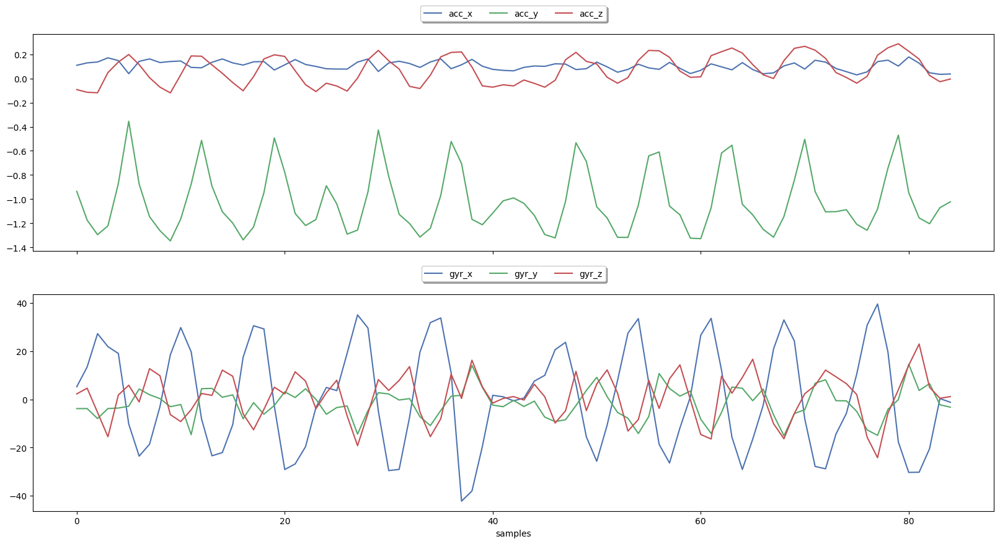

In [10]:
# --------------------------------------------------------------
# Combine plots in one figure
# --------------------------------------------------------------

label = "row"
participant = "A"
combined_plots_df = df.query("label == @label").query("participant == @participant").reset_index(drop=True)

fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
combined_plots_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
combined_plots_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

ax[0].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True,shadow=True)
ax[1].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True,shadow=True)
ax[1].set_xlabel("samples")

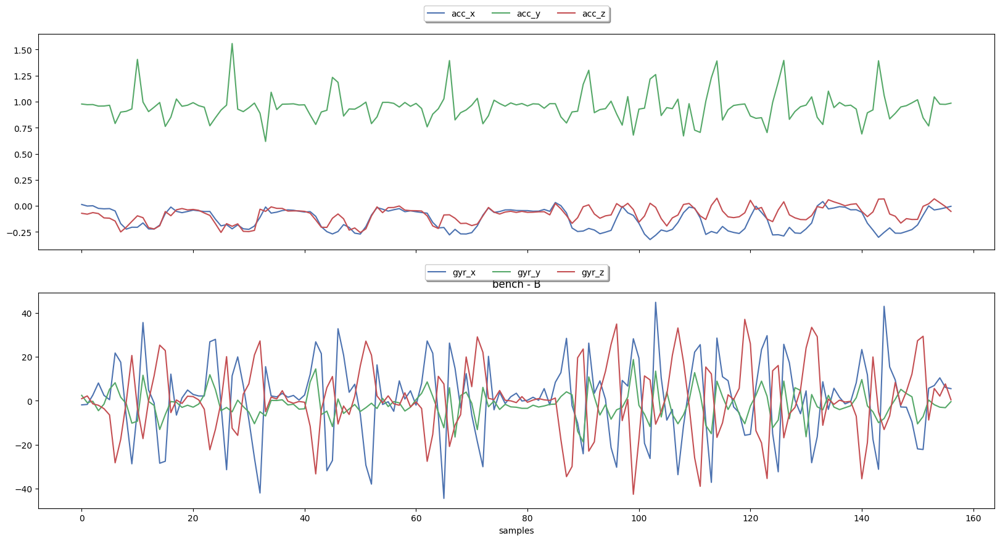

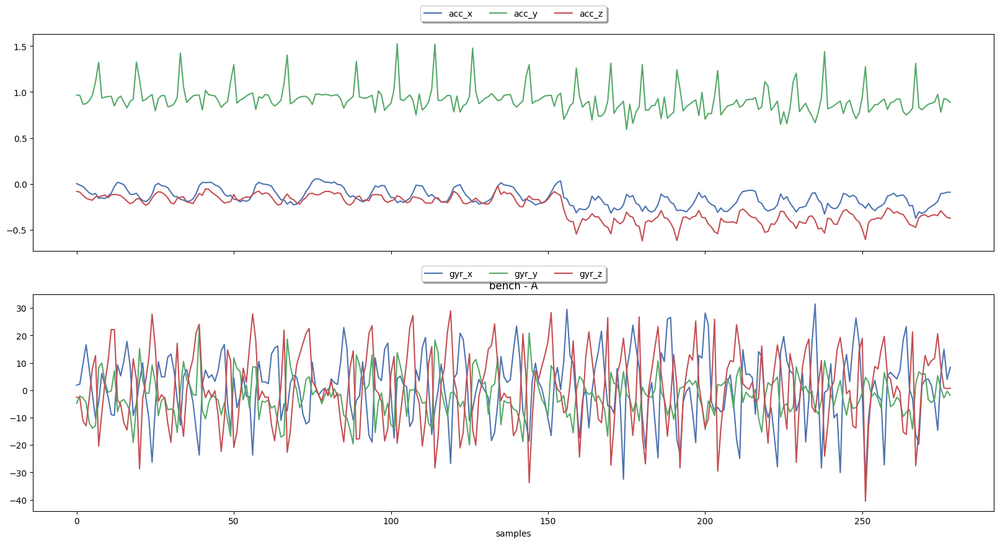

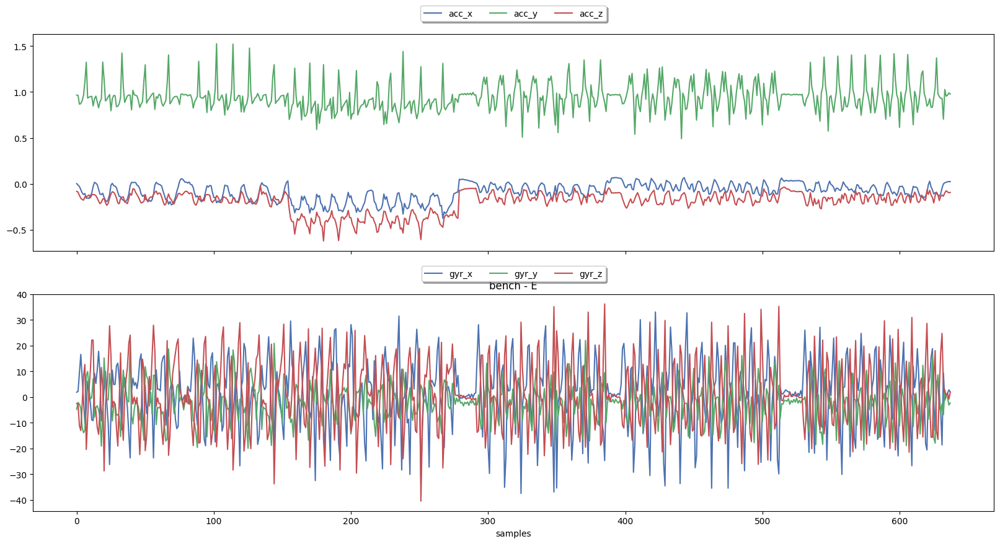

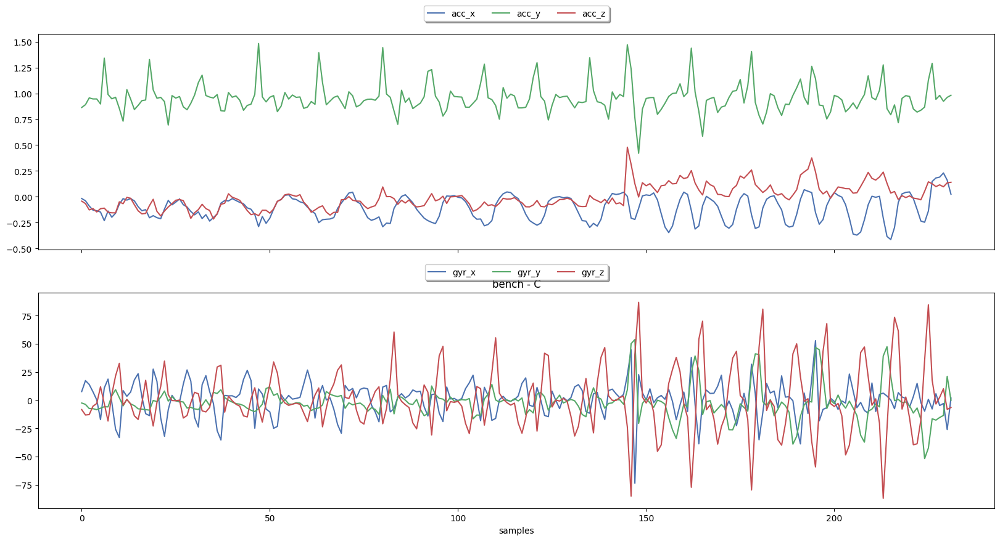

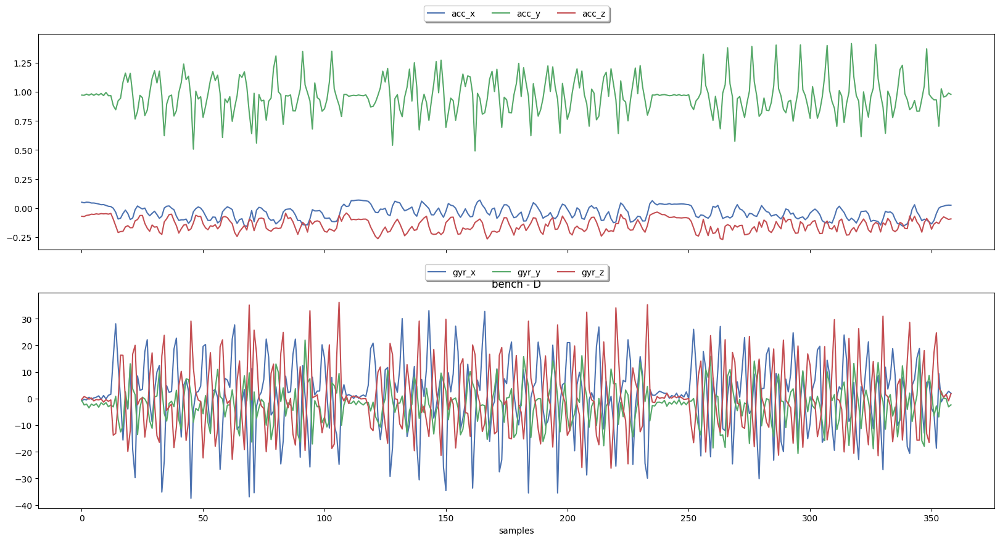

...

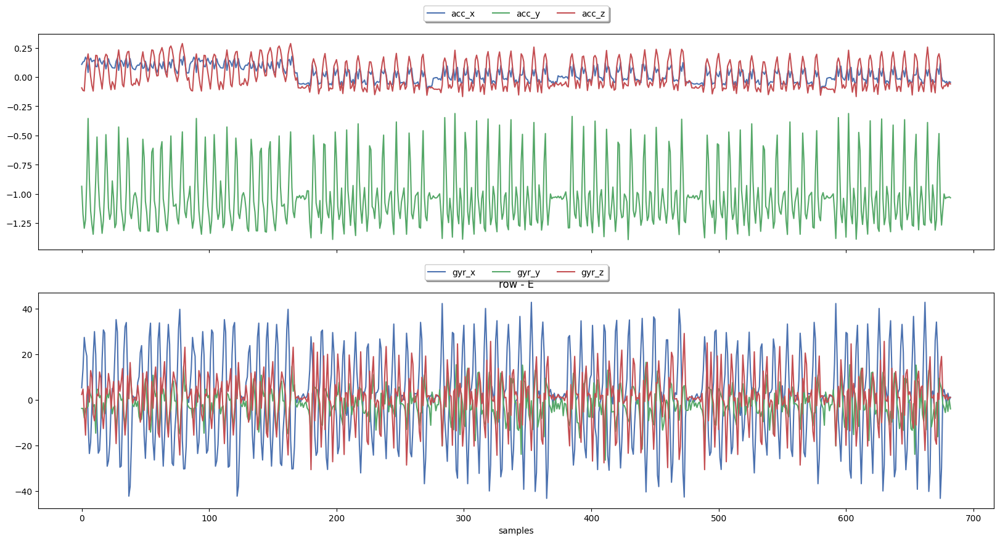

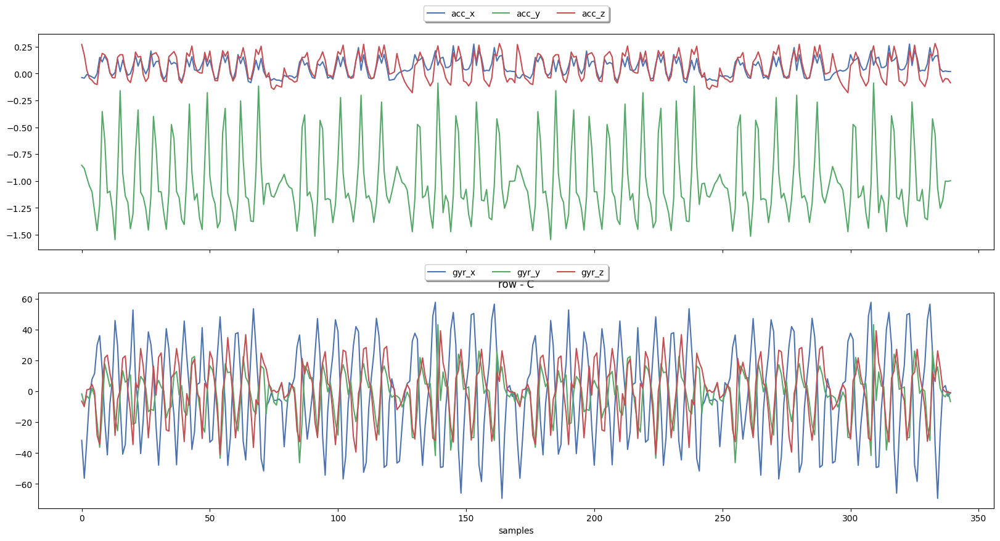

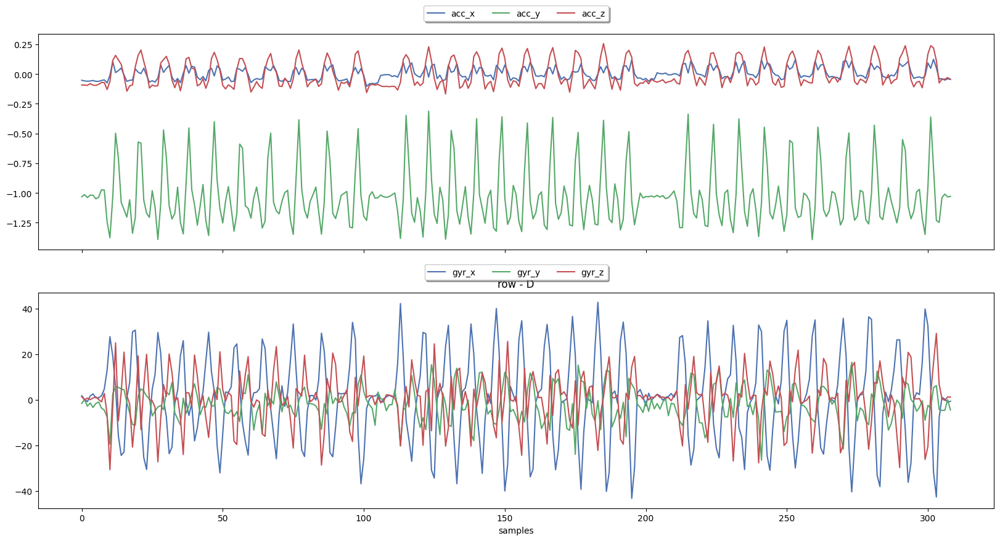

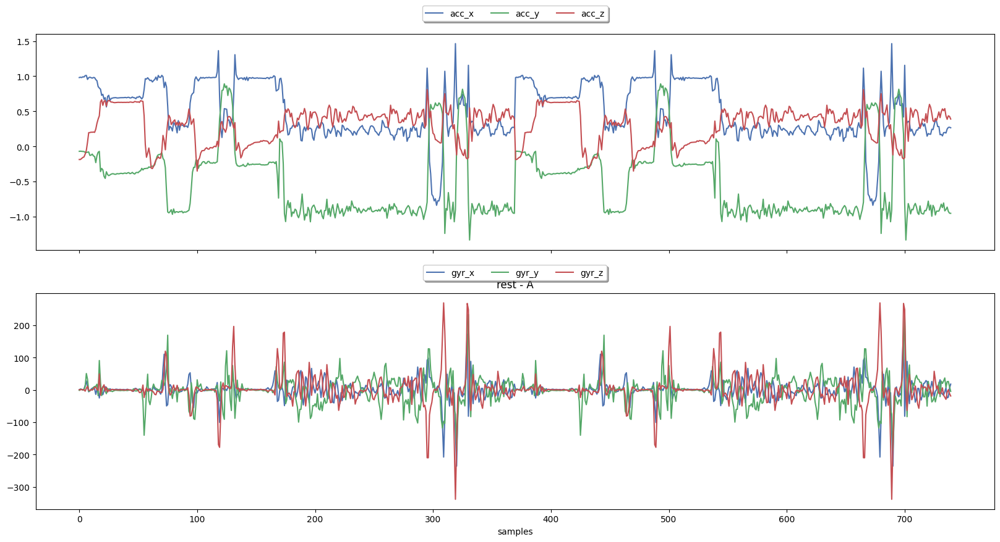

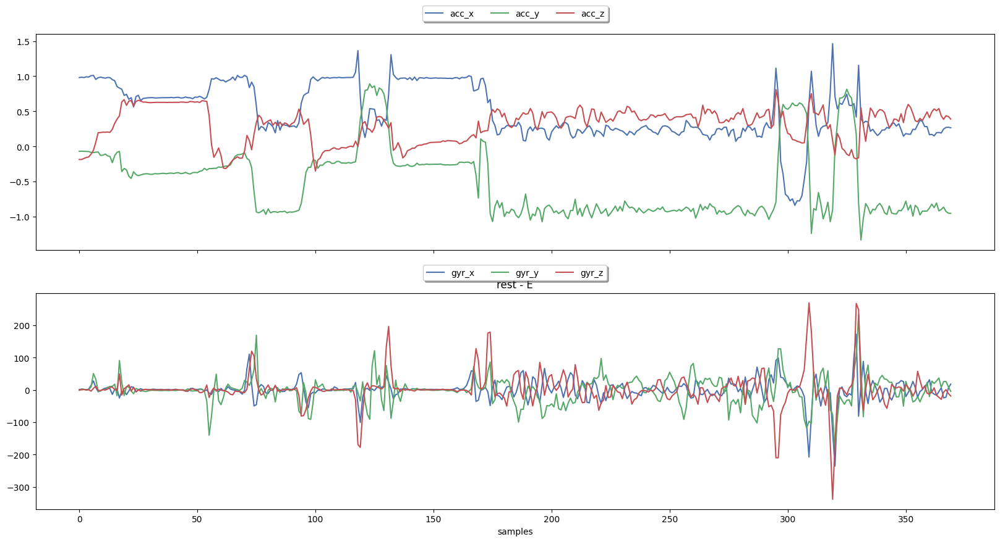

In [11]:
# --------------------------------------------------------------
# Loop over all combinations and export for both sensors
# --------------------------------------------------------------

labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        combined_plots_df = (df.query("label == @label").query("participant == @participant").reset_index())
        if len(combined_plots_df) > 0:
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            combined_plots_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            combined_plots_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

            ax[0].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True,shadow=True)
            ax[1].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True,shadow=True)
            ax[1].set_xlabel("samples")
            plt.title(f"{label} - {participant}")
            plt.savefig(f"../../reports/figures/{label.title()}_{participant}.png")
            plt.show()